In [1]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.io import wavfile
import wave
import sys
import math
import contextlib
import IPython 

fname = 'samples/eminem-30s.wav'
outname = 'samples/eminem-f.wav'

cutOffFrequency = 1000.0

# from http://stackoverflow.com/questions/13728392/moving-average-or-running-mean
def running_mean(x, windowSize):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[windowSize:] - cumsum[:-windowSize]) / windowSize

# from http://stackoverflow.com/questions/2226853/interpreting-wav-data/2227174#2227174
def interpret_wav(raw_bytes, n_frames, n_channels, sample_width, interleaved = True):

    if sample_width == 1:
        dtype = np.uint8 # unsigned char
    elif sample_width == 2:
        dtype = np.int16 # signed 2-byte short
    else:
        raise ValueError("Only supports 8 and 16 bit audio formats.")

    channels = np.frombuffer(raw_bytes, dtype=dtype)

    if interleaved:
        # channels are interleaved, i.e. sample N of channel M follows sample N of channel M-1 in raw data
        channels.shape = (n_frames, n_channels)
        channels = channels.T
    else:
        # channels are not interleaved. All samples from channel M occur before all samples from channel M-1
        channels.shape = (n_channels, n_frames)

    return channels

with contextlib.closing(wave.open(fname,'rb')) as spf:
    sampleRate = spf.getframerate()
    ampWidth = spf.getsampwidth()
    nChannels = spf.getnchannels()
    nFrames = spf.getnframes()

    # Extract Raw Audio from multi-channel Wav File
    signal = spf.readframes(nFrames*nChannels)
    spf.close()
    channels = interpret_wav(signal, nFrames, nChannels, ampWidth, True)

    # get window size
    # from http://dsp.stackexchange.com/questions/9966/what-is-the-cut-off-frequency-of-a-moving-average-filter
    freqRatio = (cutOffFrequency/sampleRate)
    N = int(math.sqrt(0.196196 + freqRatio**2)/freqRatio)

    # Use moviung average (only on first channel)
    filtered = running_mean(channels[0], N).astype(channels.dtype)

    wav_file = wave.open(outname, "w")
    wav_file.setparams((1, ampWidth, sampleRate, nFrames, spf.getcomptype(), spf.getcompname()))
    wav_file.writeframes(filtered.tobytes('C'))
    wav_file.close()

#### [Play audio] Eminem Original audio

In [2]:
audio_file = 'samples/eminem-30s.wav'

IPython.display.Audio( audio_file )

#### [Play audio] Eminem after filter

In [3]:
audio_file = 'samples/eminem-f.wav'

IPython.display.Audio( audio_file )

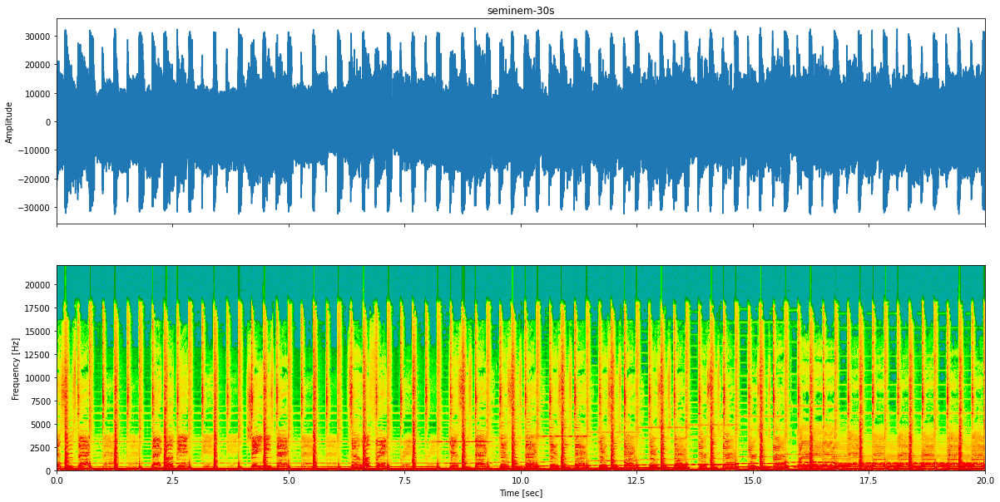

In [2]:
def get_start_end_frames(nFrames, sampleRate, tStart=None, tEnd=None):

    if tStart and tStart*sampleRate<nFrames:
        start = tStart*sampleRate
    else:
        start = 0

    if tEnd and tEnd*sampleRate<nFrames and tEnd*sampleRate>start:
        end = tEnd*sampleRate
    else:
        end = nFrames

    return (start,end,end-start)

def extract_audio(fname, tStart=None, tEnd=None):
    with contextlib.closing(wave.open(fname,'rb')) as spf:
        sampleRate = spf.getframerate()
        ampWidth = spf.getsampwidth()
        nChannels = spf.getnchannels()
        nFrames = spf.getnframes()

        startFrame, endFrame, segFrames = get_start_end_frames(nFrames, sampleRate, tStart, tEnd)

        # Extract Raw Audio from multi-channel Wav File
        spf.setpos(startFrame)
        sig = spf.readframes(segFrames)
        spf.close()

        channels = interpret_wav(sig, segFrames, nChannels, ampWidth, True)

        return (channels, nChannels, sampleRate, ampWidth, nFrames)

def convert_to_mono(channels, nChannels, outputType):
    if nChannels == 2:
        samples = np.mean(np.array([channels[0], channels[1]]), axis=0)  # Convert to mono
    else:
        samples = channels[0]

    return samples.astype(outputType)

def plot_specgram(samples, sampleRate, tStart=None, tEnd=None):
    plt.figure(figsize=(20,10))
    plt.specgram(samples, Fs=sampleRate, NFFT=1024, noverlap=192, cmap='nipy_spectral', xextent=(tStart,tEnd))
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.show()

def plot_audio_samples(title, samples, sampleRate, tStart=None, tEnd=None):
    if not tStart:
        tStart = 0

    if not tEnd or tStart>tEnd:
        tEnd = len(samples)/sampleRate

    f, axarr = plt.subplots(2, sharex=True, figsize=(20,10))
    axarr[0].set_title(title)
    axarr[0].plot(np.linspace(tStart, tEnd, len(samples)), samples)
    axarr[1].specgram(samples, Fs=sampleRate, NFFT=1024, noverlap=192, cmap='nipy_spectral', xextent=(tStart,tEnd))
    #get_specgram(axarr[1], samples, sampleRate, tStart, tEnd)

    axarr[0].set_ylabel('Amplitude')
    axarr[1].set_ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')

    plt.show()

tStart=0
tEnd=20

channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/eminem-30s.wav', tStart, tEnd)
samples = convert_to_mono(channels, nChannels, np.int16)

plot_audio_samples("seminem-30s", samples, sampleRate, tStart, tEnd)

wavfile.write('samples/eminem-30s-filtred.wav', sampleRate, samples)

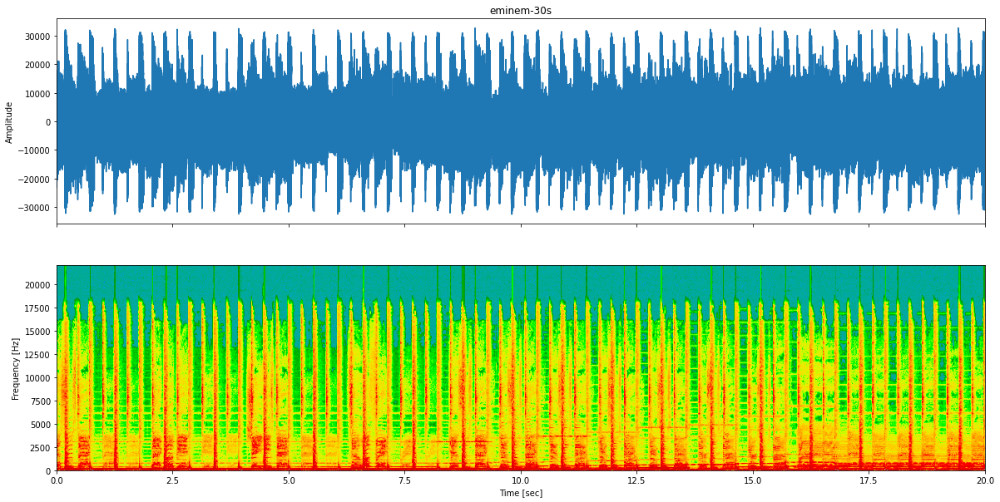

In [5]:
tStart=0
tEnd=20

channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/eminem-30s.wav', tStart, tEnd)
samples = convert_to_mono(channels, nChannels, np.int16)

plot_audio_samples("eminem-30s", samples, sampleRate, tStart, tEnd)

wavfile.write('samples/eminem-30s-2.wav', sampleRate, samples)

## Definire Filtre Trece Jos, Trece Sus, Trece Banda si Opreste Banda

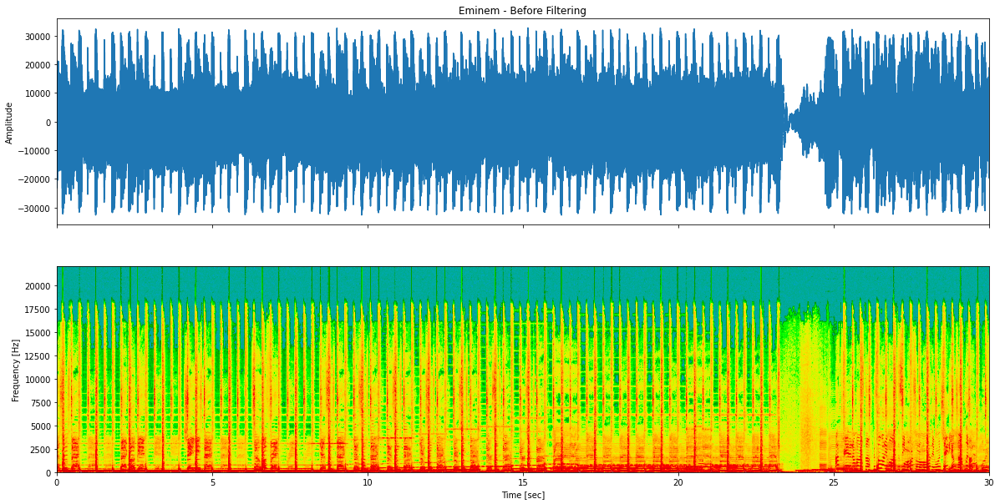

In [3]:
def fir_high_pass(samples, fs, fH, N, outputType):
    # Referece: https://fiiir.com

    fH = fH / fs

    # Compute sinc filter.
    h = np.sinc(2 * fH * (np.arange(N) - (N - 1) / 2.))
    # Apply window.
    h *= np.hamming(N)
    # Normalize to get unity gain.
    h /= np.sum(h)
    # Create a high-pass filter from the low-pass filter through spectral inversion.
    h = -h
    h[int((N - 1) / 2)] += 1
    # Applying the filter to a signal s can be as simple as writing
    s = np.convolve(samples, h).astype(outputType)
    return s


def fir_low_pass(samples, fs, fL, N, outputType):
    # Referece: https://fiiir.com

    fL = fL / fs

    # Compute sinc filter.
    h = np.sinc(2 * fL * (np.arange(N) - (N - 1) / 2.))
    # Apply window.
    h *= np.hamming(N)
    # Normalize to get unity gain.
    h /= np.sum(h)
    # Applying the filter to a signal s can be as simple as writing
    s = np.convolve(samples, h).astype(outputType)
    return s

def fir_band_reject(samples, fs, fL, fH, NL, NH, outputType):
    # Referece: https://fiiir.com

    fH = fH / fs
    fL = fL / fs

    # Compute a low-pass filter with cutoff frequency fL.
    hlpf = np.sinc(2 * fL * (np.arange(NL) - (NL - 1) / 2.))
    hlpf *= np.blackman(NL)
    hlpf /= np.sum(hlpf)
    # Compute a high-pass filter with cutoff frequency fH.
    hhpf = np.sinc(2 * fH * (np.arange(NH) - (NH - 1) / 2.))
    hhpf *= np.blackman(NH)
    hhpf /= np.sum(hhpf)
    hhpf = -hhpf
    hhpf[int((NH - 1) / 2)] += 1
    # Add both filters.
    if NH >= NL:
        h = hhpf
        h[int((NH - NL) / 2) : int((NH - NL) / 2 + NL)] += hlpf
    else:
        h = hlpf
        h[int((NL - NH) / 2) : int((NL - NH) / 2 + NH)] += hhpf
    # Applying the filter to a signal s can be as simple as writing
    s = np.convolve(samples, h).astype(outputType)

    return s

def fir_band_pass(samples, fs, fL, fH, NL, NH, outputType):
    # Referece: https://fiiir.com

    fH = fH / fs
    fL = fL / fs

    # Compute a low-pass filter with cutoff frequency fH.
    hlpf = np.sinc(2 * fH * (np.arange(NH) - (NH - 1) / 2.))
    hlpf *= np.blackman(NH)
    hlpf /= np.sum(hlpf)
    # Compute a high-pass filter with cutoff frequency fL.
    hhpf = np.sinc(2 * fL * (np.arange(NL) - (NL - 1) / 2.))
    hhpf *= np.blackman(NL)
    hhpf /= np.sum(hhpf)
    hhpf = -hhpf
    hhpf[int((NL - 1) / 2)] += 1
    # Convolve both filters.
    h = np.convolve(hlpf, hhpf)
    # Applying the filter to a signal s can be as simple as writing
    s = np.convolve(samples, h).astype(outputType)

    return s

tStart = 0
tEnd = 30

channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/eminem-30s.wav', tStart, tEnd)
samples = convert_to_mono(channels, nChannels, np.int16)

plot_audio_samples("Eminem - Before Filtering", samples, sampleRate, tStart, tEnd)



In [10]:
nFrames

1323000

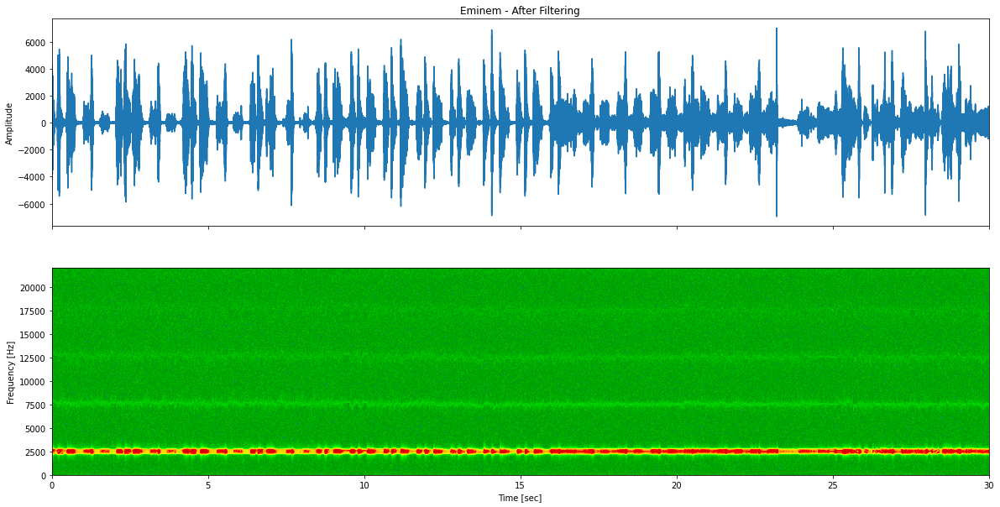

In [7]:
samples_filtered = fir_band_pass(samples, sampleRate, 2400, 2600, 461, 461, np.int16)
samples_filtered = samples_filtered * 2 # Sound amplification
plot_audio_samples("Eminem - After Filtering", samples_filtered, sampleRate, tStart, tEnd)

wavfile.write('samples/Eminem-greiere.wav', sampleRate, samples_filtered)


In [7]:
samples_filtered

array([0, 0, 0, ..., 0, 0, 0], dtype=int16)

### Melodia Originala

In [8]:
audio_file = 'samples/eminem-30s.wav'

IPython.display.Audio( audio_file )

### Dupa Filtru 

In [9]:
audio_file2 = 'samples/Eminem-greiere.wav'

IPython.display.Audio( audio_file2 )

## Extragere Voce

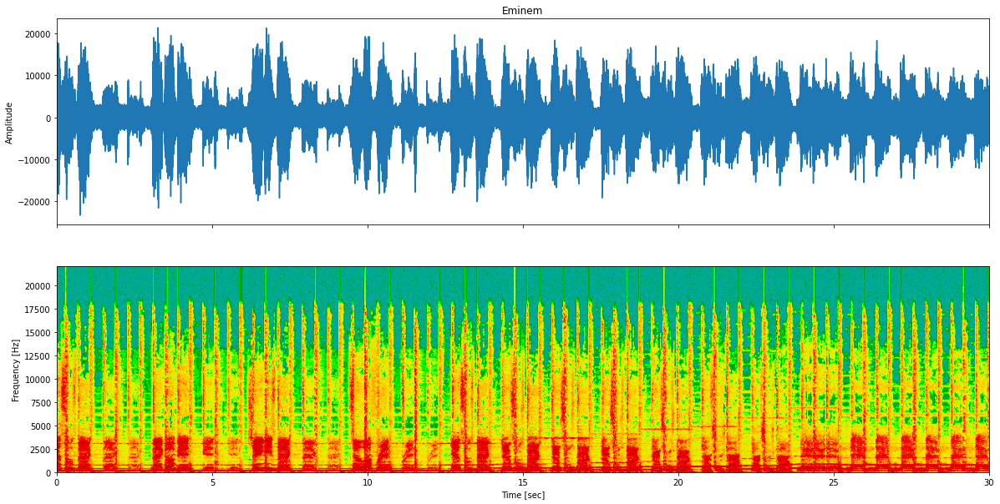

In [11]:
channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/eminem-30s.wav', tStart, 20)
samples_no_voice = (channels[0]-channels[1]).astype(np.int16)
plot_audio_samples("Eminem", samples_no_voice, sampleRate, tStart, tEnd)

wavfile.write('samples/eminem-voce.wav', sampleRate, samples_no_voice)


In [12]:
audio_file2 = 'samples/Eminem-Voce.wav'

IPython.display.Audio( audio_file2 )

## Sinusoida 20-20000 hz 

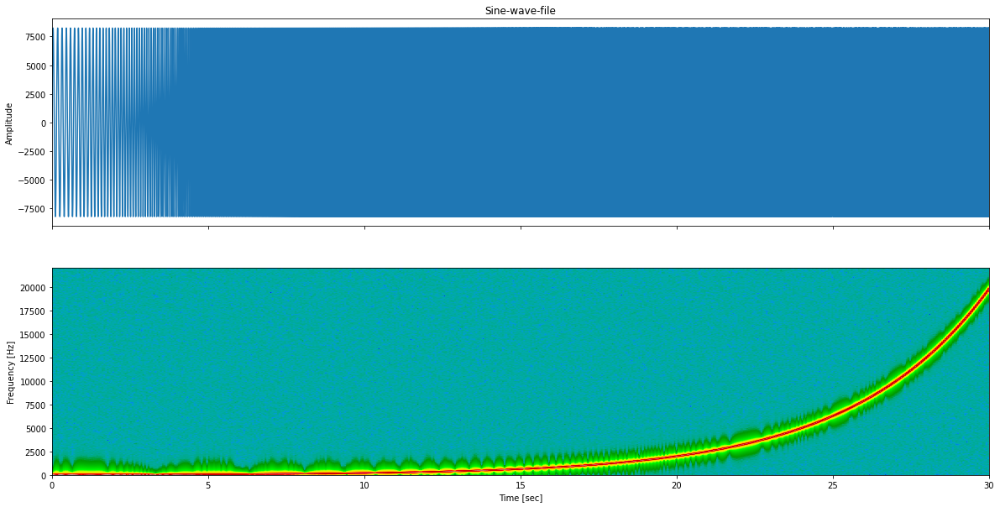

C:\Users\mariu\anaconda3\envs\am\lib\site-packages\matplotlib\axes\_axes.py:7626: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


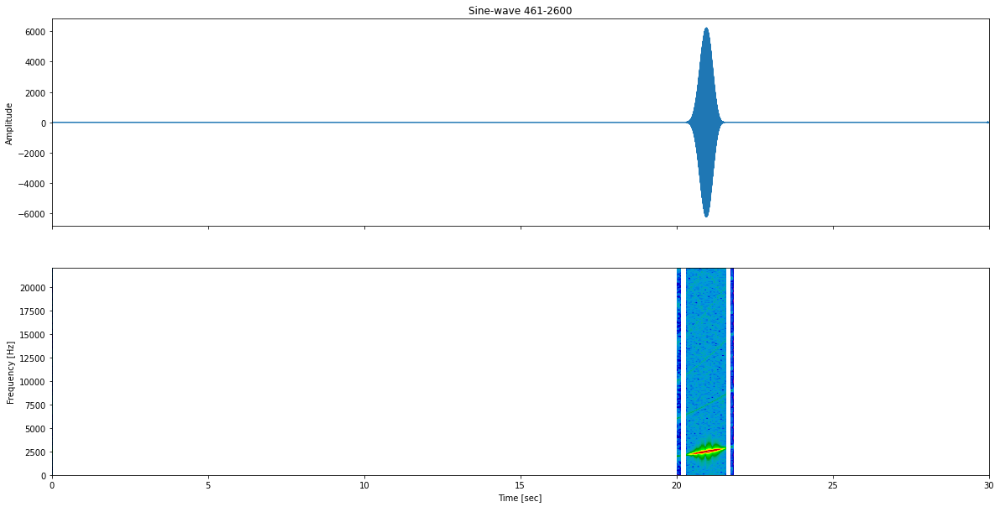

In [4]:
channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/sine_20-20khz.wav', 0, 10)
samples = convert_to_mono(channels, nChannels, np.int16)
plot_audio_samples("Sine-wave-file", samples, sampleRate, tStart, tEnd)

samples_filtered = fir_band_pass(samples, sampleRate, 2400, 2600, 461, 461, np.int16)

plot_audio_samples("Sine-wave 461-2600", samples_filtered, sampleRate, tStart, tEnd)

wavfile.write('samples/Sine-wave-filtru.wav', sampleRate, samples_filtered)


In [5]:
import audio_metadata

metadata = audio_metadata.load( 'samples/sine_20-20khz.wav' )
print(metadata)

<WAVE({
    'filepath': 'C:\\Users\\mariu\\Documents\\facultate\\Anul3\\sem2\\AM\\Laborator 4-20220401\\samples\\sine_20-20khz.wav',
    'filesize': '1.68 MiB',
    'pictures': [],
    'streaminfo': <WAVEStreamInfo({

        'audio_format': <WAVEAudioFormat.PCM>,

        'bit_depth': 16,

        'bitrate': '1411 Kbps',

        'channels': 2,

        'duration': '00:10',

        'sample_rate': '44.1 KHz',

    })>,
    'tags': <RIFFTags({

        '\x01ISF': ['Sound Forge Pro 10.0\x00\x02'],

        'IENG': ['went smith'],

        'date': ['2010-04-06'],

    })>,
})>


In [14]:
audio_file2 = 'samples/Sine-wave-filtru.wav'

IPython.display.Audio( audio_file2 )

## TODO
Folsind fișierul audio "sine_20-20khz.wav", implementati un filtru trece jos, trece sus si opreste banda, dupa exemplul anterior, frecventele de taiere fiind valori alese de voi. Afisati cele doua grafice pentru amplitudine si frecventa pentru cele trei filtre. Ascultati fisierele audio generate dupa filtrare. 

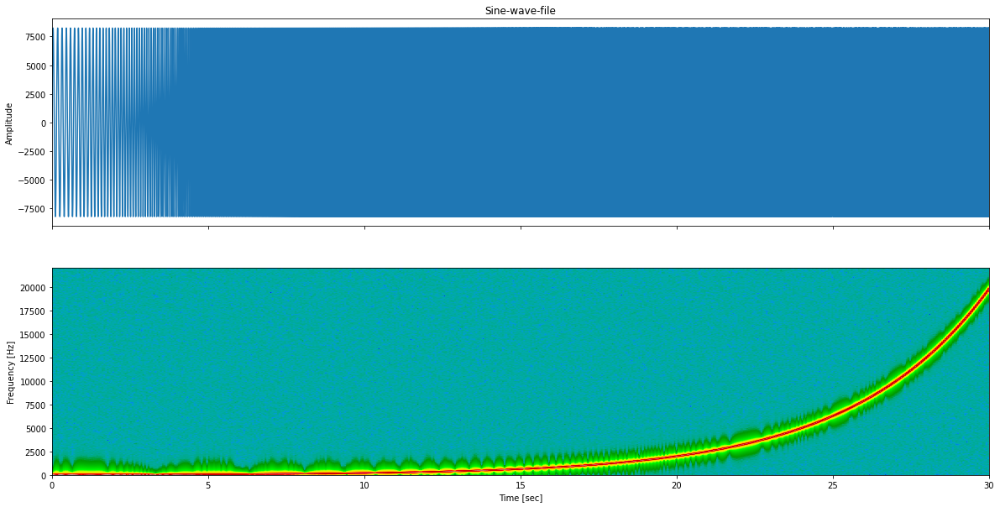

C:\Users\mariu\anaconda3\envs\am\lib\site-packages\matplotlib\axes\_axes.py:7626: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


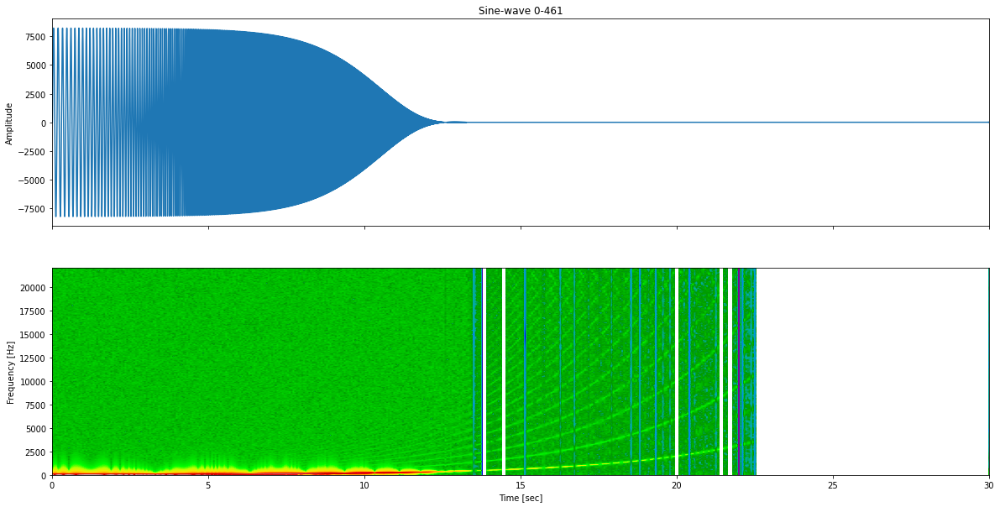

In [27]:
# filtru trece jos
channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/sine_20-20khz.wav', 0, 10)
samples = convert_to_mono(channels, nChannels, np.int16)
plot_audio_samples("Sine-wave-file", samples, sampleRate, tStart, tEnd)

samples_filtered = fir_low_pass(samples, sampleRate, 200, 461, np.int16)
plot_audio_samples("Sine-wave 0-200", samples_filtered, sampleRate, tStart, tEnd)

wavfile.write('samples/Sine-wave-filtru_trece_jos.wav', sampleRate, samples_filtered)

audio_file2 = 'samples/Sine-wave-filtru_trece_jos.wav'

IPython.display.Audio( audio_file2 )

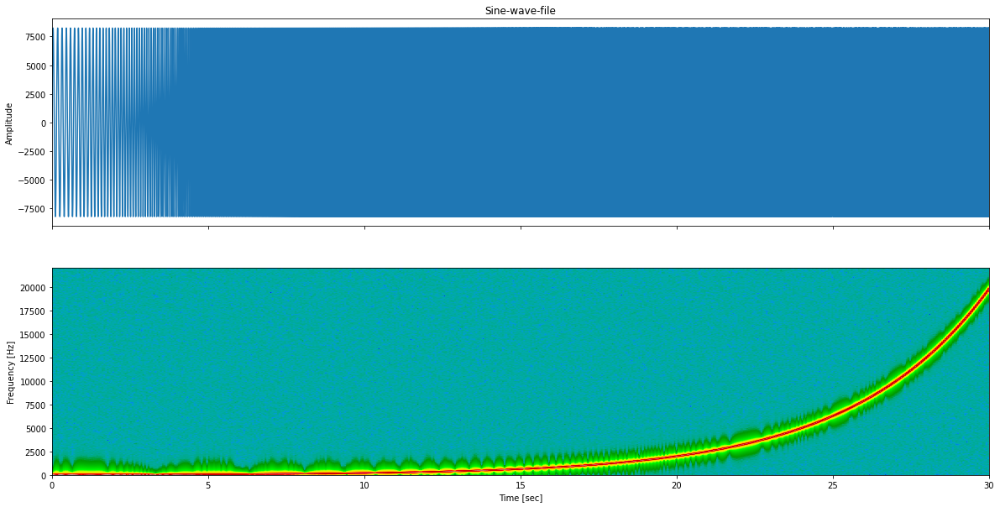

C:\Users\mariu\anaconda3\envs\am\lib\site-packages\matplotlib\axes\_axes.py:7626: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


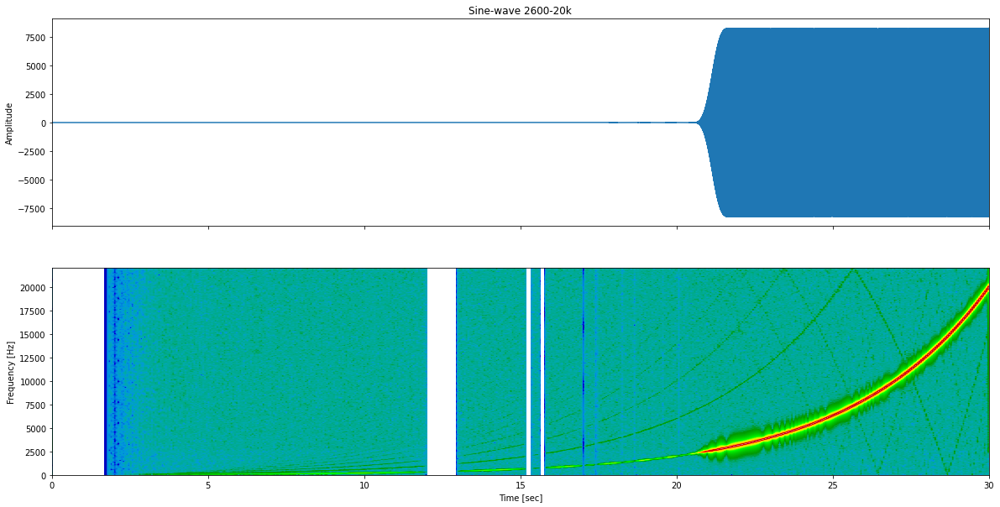

In [29]:
# filtru trece sus
channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/sine_20-20khz.wav', 0, 10)
samples = convert_to_mono(channels, nChannels, np.int16)
plot_audio_samples("Sine-wave-file", samples, sampleRate, tStart, tEnd)

samples_filtered = fir_high_pass(samples, sampleRate, 2600, 261, np.int16)
plot_audio_samples("Sine-wave 2600+", samples_filtered, sampleRate, tStart, tEnd)

wavfile.write('samples/Sine-wave-filtru_trece_sus.wav', sampleRate, samples_filtered)

audio_file2 = 'samples/Sine-wave-filtru_trece_sus.wav'

IPython.display.Audio( audio_file2 )

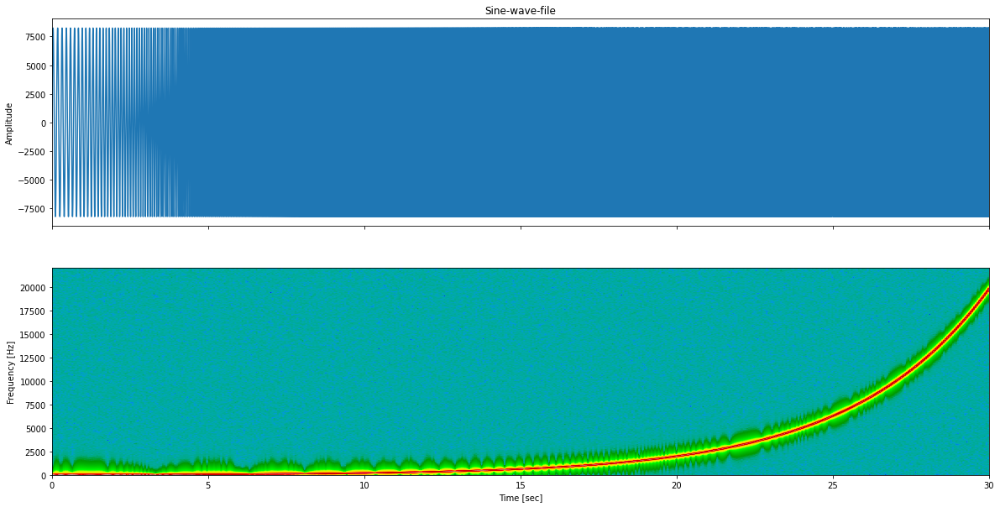

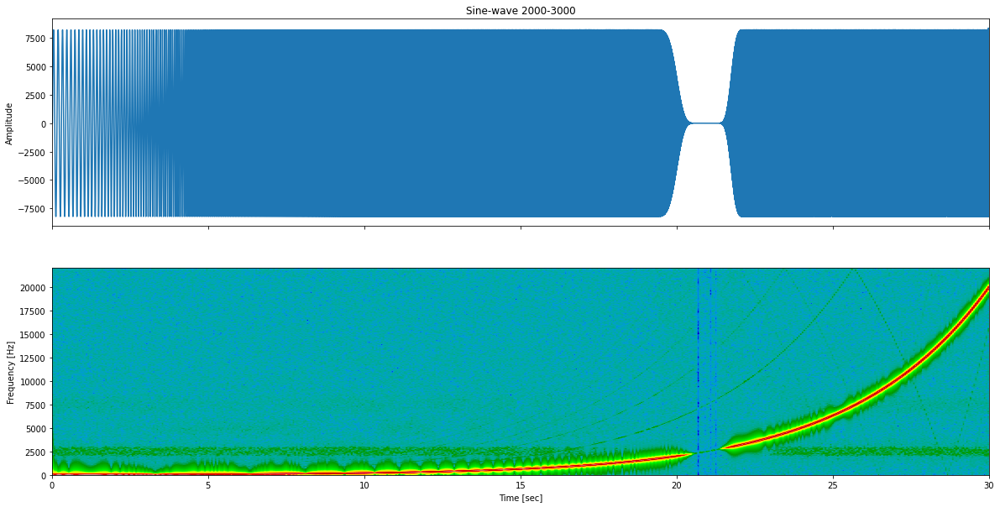

In [31]:
# filtru stop banda
channels, nChannels, sampleRate, ampWidth, nFrames = extract_audio('samples/sine_20-20khz.wav', 0, 10)
samples = convert_to_mono(channels, nChannels, np.int16)
plot_audio_samples("Sine-wave-file", samples, sampleRate, tStart, tEnd)


samples_filtered = fir_band_reject(samples, sampleRate, 2000, 3000, 461, 461, np.int16)
plot_audio_samples("Sine-wave 2000-3000", samples_filtered, sampleRate, tStart, tEnd)

wavfile.write('samples/Sine-wave-filtru_stop_banda.wav', sampleRate, samples_filtered)

audio_file2 = 'samples/Sine-wave-filtru_stop_banda.wav'

IPython.display.Audio( audio_file2 )